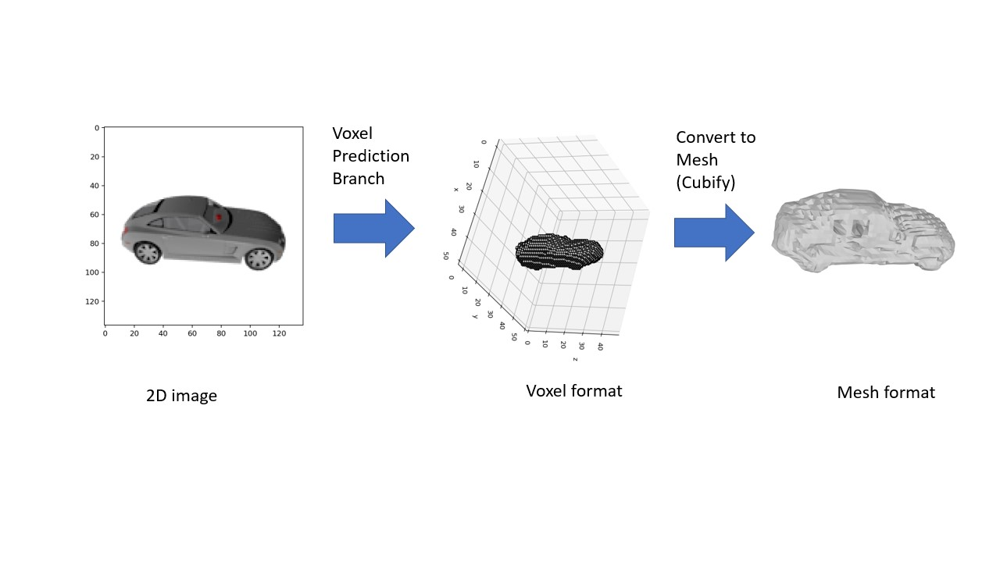

In [81]:
import argparse
import logging
import multiprocessing as mp
import numpy as np
import os
import torch
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog
from detectron2.data.detection_utils import read_image
from fvcore.common.file_io import PathManager
from detectron2.engine.defaults import DefaultPredictor
from detectron2.utils.logger import setup_logger
from pytorch3d.io import save_obj
from pytorch3d.structures import Meshes
from shapenet.data.utils import imagenet_preprocess

# required so that .register() calls are executed in module scope
import meshrcnn.data  # noqa
import meshrcnn.modeling  # noqa
import meshrcnn.utils  # noqa
from meshrcnn.config import get_meshrcnn_cfg_defaults
from meshrcnn.evaluation import transform_meshes_to_camera_coord_system

from shapenet.modeling import MeshLoss, build_model
from shapenet.config import get_shapenet_cfg
from PIL import Image
import torchvision.transforms as T

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from shapenet.utils import Checkpoint, clean_state_dict
import cv2

In [82]:
cfg = get_shapenet_cfg()
cfg.merge_from_file("configs/shapenet/voxmesh_R50.yaml")
cfg.freeze() 

In [83]:
predictor = build_model(cfg)
#cp = torch.load("/home/alan/Desktop/meshrcnn/output/checkpoint_with_model.pt")
cp = torch.load("/home/alan/Desktop/meshrcnn/voxmesh_R50.pth")
state_dict = clean_state_dict(cp["best_states"]["model"])
predictor.load_state_dict(state_dict)
 
sample_image = "sample/02.png"
with PathManager.open(sample_image, "rb") as f:
  image = Image.open(f).convert("RGB")
  transform = [T.ToTensor()]
  transform = T.Compose(transform)    
  image = transform(image)
  image = image[None, :]
  voxel_scores, meshes_pred = predictor(image)
  verts, faces = meshes_pred[0].get_mesh_verts_faces(0) 

import plotly.graph_objects as go
import numpy as np

x = verts[:, 0].detach().numpy()
y = verts[:, 1].detach().numpy()
z = verts[:, 2].detach().numpy()
i = faces[:, 0].detach().numpy()
j = faces[:, 1].detach().numpy()
k = faces[:, 2].detach().numpy()

fig = go.Figure(data=go.Mesh3d(
    x=x, 
    y=y, 
    z=z, 
    i=i,
    j=j,
    k=k,    
    color='lightpink', 
    opacity=0.50)
    )
fig.show()

/home/alan/miniconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.

/home/alan/miniconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.

/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:26: UserWarning:

__floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor 

In [84]:
sample_image = "sample/04.png"
with PathManager.open(sample_image, "rb") as f:
  image = Image.open(f).convert("RGB")
  transform = [T.ToTensor()]
  transform = T.Compose(transform)    
  image = transform(image)
  image = image[None, :]
  voxel_scores, meshes_pred = predictor(image)
  verts_2, faces_2 = meshes_pred[0].get_mesh_verts_faces(0)

 

x = verts_2[:, 0].detach().numpy()
y = verts_2[:, 1].detach().numpy()
z = verts_2[:, 2].detach().numpy()
i = faces_2[:, 0].detach().numpy()
j = faces_2[:, 1].detach().numpy()
k = faces_2[:, 2].detach().numpy()

fig = go.Figure(data=go.Mesh3d(
    x=x, 
    y=y, 
    z=z, 
    i=i,
    j=j,
    k=k,    
    color='lightpink', 
    opacity=0.50)
    )
fig.show()

/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:26: UserWarning:

__floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').

/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:27: UserWarning:

__floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').

/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:28: UserWarnin

In [85]:
from pytorch3d.ops import points_alignment
verts = verts[None, :]
verts_2 = verts_2[None, :]
print(verts.shape)
iCPSolution = points_alignment.iterative_closest_point(X = verts, Y = verts_2)

torch.Size([1, 2422, 3])


In [86]:
verts = points_alignment._apply_similarity_transform(verts, iCPSolution.RTs.R, iCPSolution.RTs.T, iCPSolution.RTs.s)

In [87]:
verts = torch.squeeze(verts)
x = verts[:, 0].detach().numpy()
y = verts[:, 1].detach().numpy()
z = verts[:, 2].detach().numpy()
i = faces[:, 0].detach().numpy()
j = faces[:, 1].detach().numpy()
k = faces[:, 2].detach().numpy()

fig = go.Figure(data=go.Mesh3d(
    x=x, 
    y=y, 
    z=z, 
    i=i,
    j=j,
    k=k,    
    color='lightpink', 
    opacity=0.50)
    )
fig.show()

In [48]:
voxel_probs = voxel_scores.sigmoid()
voxel_probs_np = voxel_probs[0].detach().numpy()

import plotly.graph_objects as go
import numpy as np
X, Y, Z = np.mgrid[0:48:48j, 0:48:48j, 0:48:48j]

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=voxel_probs_np.flatten(),
    isomin=0,
    isomax=1,
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=20, # needs to be a large number for good volume rendering
    ))
fig.show()


In [7]:
from shapenet.config import get_shapenet_cfg
from shapenet.data import build_data_loader
from shapenet.data import train_net_shapenet
from shapenet.utils import Timer

cfg = train_net_shapenet.setup()
loaders = train_net_shapenet.setup_loaders(cfg)

[11/28 11:04:02 shapenet]: Using 0 GPUs per machine. Rank of current process: 0
[11/28 11:04:02 shapenet]: Environment info:
----------------------  ---------------------------------------------------------------------
sys.platform            linux
Python                  3.9.12 (main, Apr  5 2022, 06:56:58) [GCC 7.5.0]
numpy                   1.21.5
detectron2              0.6 @/home/alan/miniconda3/lib/python3.9/site-packages/detectron2
Compiler                GCC 9.4
CUDA compiler           CUDA 11.7
detectron2 arch flags   8.6
DETECTRON2_ENV_MODULE   <not set>
PyTorch                 1.12.1 @/home/alan/miniconda3/lib/python3.9/site-packages/torch
PyTorch debug build     False
GPU available           Yes
GPU 0                   NVIDIA RTX A5000 (arch=8.6)
Driver version          515.48.07
CUDA_HOME               /home/alan/miniconda3
Pillow                  9.2.0
torchvision             0.13.1 @/home/alan/miniconda3/lib/python3.9/site-packages/torchvision
torchvision arch flags  3.5

[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 03636649
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 03691459
[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 03691459
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 04090263
[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 04090263
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 04256520
[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 04256520
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 04379243
[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 04379243
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 04401088
[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 04401088
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 04530566
[11/28 11:04:02 shapenet.data.mesh_vox]: Skipping synset 04530566
[11/28 11:04:02 shapenet.data.build_data_loader]: Building dataset for split "val"
[11/28 11:04:02 shapenet.data.mesh_vox]: Starting synset 02

torch.Size([20471, 3])


<IPython.core.display.Javascript object>


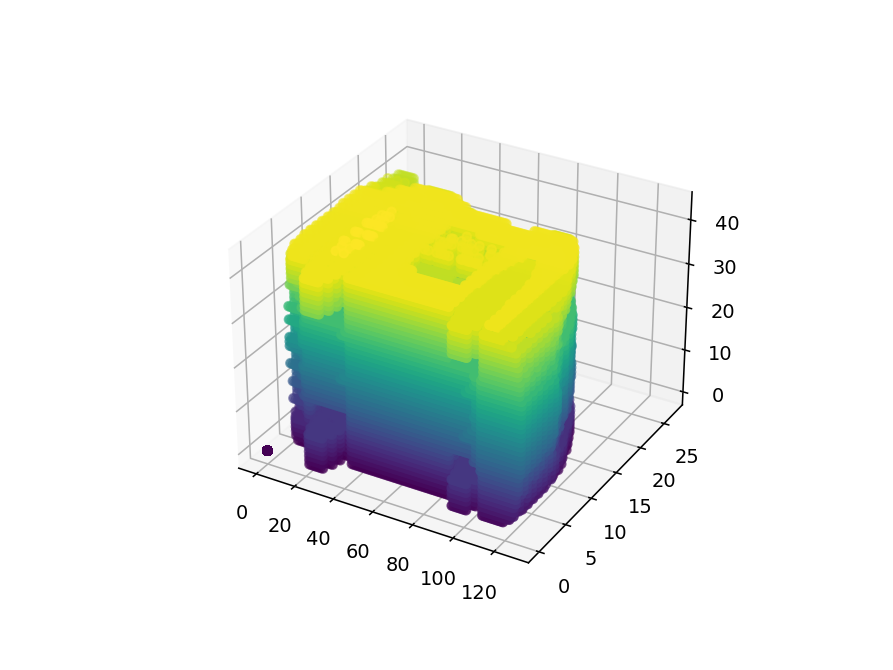

In [8]:
from shapenet.utils.binvox_torch import read_binvox_coords
voxel_path = "/media/alan/OS/Users/alanx/Desktop/phd/meshrcnn/datasets/shapenet/shapnet/ShapeNetCore.v1.binvox/ShapeNetCore.v1/02958343/1b318e41d5143e7a33ae101d4377190c/model.binvox"
obj_path = "/media/alan/OS/Users/alanx/Desktop/phd/meshrcnn/datasets/shapenet/shapnet/ShapeNetCore.v1/ShapeNetCore.v1/02958343/1b318e41d5143e7a33ae101d4377190c/model.obj"
with open(voxel_path, "rb") as f:
    # Read voxel coordinates as a tensor of shape (N, 3)
    voxel_coords = read_binvox_coords(f)
print(voxel_coords.shape)    

def align_bbox(src, tgt):
    """
    Return a copy of src points in the coordinate system of tgt by applying a
    scale and shift along each coordinate axis to make the min / max values align
    Inputs:
    - src, tgt: Torch Tensor of shape (N, 3)
    Returns:
    - out: Torch Tensor of shape (N, 3)
    """
    src_min = src.min(dim=0)[0]
    src_max = src.max(dim=0)[0]
    tgt_min = tgt.min(dim=0)[0]
    tgt_max = tgt.max(dim=0)[0]
    scale = (tgt_max - tgt_min) / (src_max - src_min)
    shift = tgt_min - scale * src_min
    out = scale * src + shift
    return out


%matplotlib notebook
from mpl_toolkits import mplot3d

xdata = np.zeros(31144, dtype = float)
ydata = np.zeros(31144, dtype = float)
zdata = np.zeros(31144, dtype = float)

for i, x in enumerate(voxel_coords.numpy()):
   xdata[i] = voxel_coords[i][0]
   ydata[i] = voxel_coords[i][1]
   zdata[i] = voxel_coords[i][2]    
 
ax = plt.axes(projection='3d')
ax.scatter3D(xdata, ydata, zdata, c=zdata, cmap='viridis');

torch.Size([20471, 3])


<IPython.core.display.Javascript object>


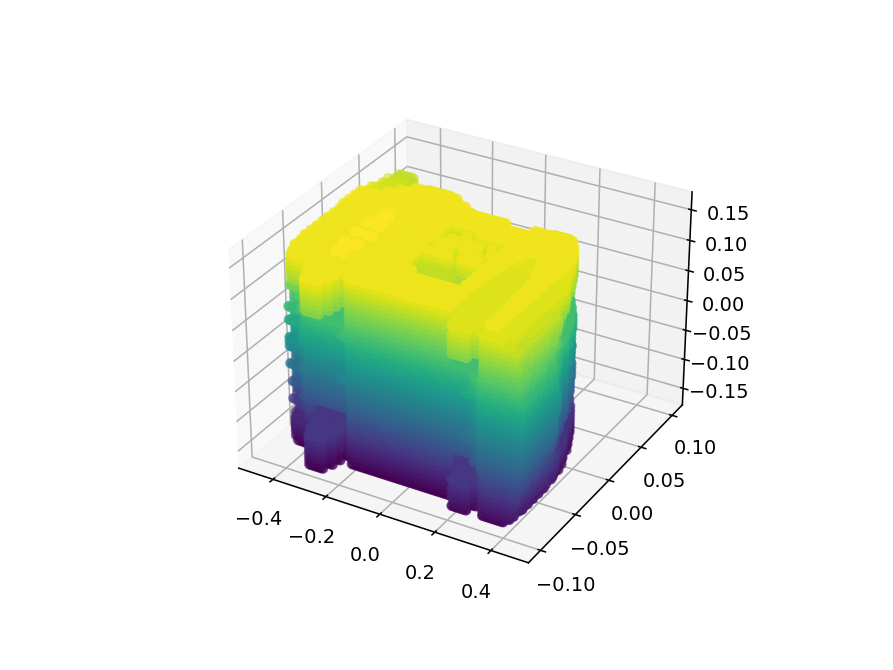

In [9]:
from pytorch3d.io import load_obj
mesh = load_obj(obj_path, load_textures=False)
verts = mesh[0]
voxel_coords = align_bbox(voxel_coords, verts)
print(voxel_coords.shape)

%matplotlib notebook
from mpl_toolkits import mplot3d

xdata = np.zeros(31144, dtype = float)
ydata = np.zeros(31144, dtype = float)
zdata = np.zeros(31144, dtype = float)

for i, x in enumerate(voxel_coords.numpy()):
   xdata[i] = voxel_coords[i][0]
   ydata[i] = voxel_coords[i][1]
   zdata[i] = voxel_coords[i][2]    
 
ax = plt.axes(projection='3d')
ax.scatter3D(xdata, ydata, zdata, c=zdata, cmap='viridis');

In [10]:
import pytorch3d.vis.plotly_vis as pv
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
index = 0
predictor.to(device)
#x = torch.tensor(())
#y = torch.tensor(())
for i, batch in enumerate(loaders["train"]):
 
    batch = loaders["train"].postprocess(batch, device)
    imgs, _, _, _, voxels_gt, id_strs = batch
    imgs = imgs.to(device)
    
    assert(len(id_strs) == 24)
 
    for i in range(len(id_strs)): 
        words = id_strs[i].split('-')
        if i == 0:
            word = words[1]
        else:
            assert(word == words[1])
            
             
    words = id_strs[0].split('-')
    output_dir = "/home/alan/Desktop/meshrcnn/datasets/shapenet/predictedVoxel"
    output_dir = os.path.join(output_dir, words[0], words[1])
    if not os.path.exists(output_dir): 
        os.makedirs(output_dir)
        output_dir = os.path.join(output_dir, "predictedVoxels.pt")
        voxel_scores, _ = predictor(imgs)
        torch.save(voxel_scores, output_dir)
    
      
    '''
    fig = px.imshow(imgs[index][0])
    fig.show()
    
    fig = make_subplots(
        rows=2, cols=2,
        specs=[[{'type': 'volume'}, {'type': 'volume'}],
               [{'type': 'volume'}, {'type': 'volume'}]])
    
    verts = meshes_gt[index].verts_packed()
    faces = meshes_gt[index].faces_packed()
    
    print(verts.shape)
    fig.add_trace(
        go.Mesh3d(
            x=verts[:, 0],
            y=verts[:, 1],
            z=verts[:, 2],
            i=faces[:, 0],
            j=faces[:, 1],
            k=faces[:, 2]
        ),
        row=1,
        col=1,
    )
    
    #meshes_gt_cubified = predictor.cubify(voxels_gt)
    
    #verts = meshes_gt_cubified[index].verts_packed().detach().numpy()
    #faces = meshes_gt_cubified[index].faces_packed().detach().numpy()

   
    verts, faces = meshes_pred[0].get_mesh_verts_faces(index)
    
     #verts = meshes_gt_cubified[index].verts_packed().detach().numpy()
    #faces = meshes_gt_cubified[index].faces_packed().detach().numpy()
    
    fig.add_trace(
        go.Mesh3d(
            x=verts[:, 0].detach().numpy(),
            y=verts[:, 1].detach().numpy(),
            z=verts[:, 2].detach().numpy(),
            i=faces[:, 0].detach().numpy(),
            j=faces[:, 1].detach().numpy(),
            k=faces[:, 2].detach().numpy()
        ),
        row=1,
        col=2,
    )
    
    voxel_probs = voxels_gt.sigmoid()
    voxel_probs_np = voxel_probs[index].detach().numpy()
    X, Y, Z = np.mgrid[0:48:48j, 0:48:48j, 0:48:48j]
 
    #print(tf.math.count_nonzero(voxels_gt))
    fig.add_trace(go.Volume(
        x=X.flatten(),
        y=Y.flatten(),
        z=Z.flatten(),
        value=voxels_gt[index].flatten(),
        isomin=0.1,
        isomax=1,
        opacity=0.1, # needs to be small to see through all surfaces
        surface_count=20, # needs to be a large number for good volume rendering
        ), row=2, col=1)
      
    voxel_probs = voxel_scores.sigmoid()
    voxel_probs_np = voxel_probs[index].detach().numpy()
    X, Y, Z = np.mgrid[0:48:48j, 0:48:48j, 0:48:48j]
    fig.add_trace(go.Volume(
        x=X.flatten(),
        y=Y.flatten(),
        z=Z.flatten(),
        value=voxel_probs_np.flatten(),
        isomin=0.2,
        isomax=1,
        opacity=0.1, # needs to be small to see through all surfaces
        surface_count=20, # needs to be a large number for good volume rendering
        ), row=2, col=2)
    fig.show()    
    
    break
    '''

voxel is not Tensor
ResNetBackbone
torch.Size([24, 3, 137, 137])


/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:26: UserWarning:

__floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').

/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:27: UserWarning:

__floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').

/home/alan/miniconda3/lib/python3.9/site-packages/pytorch3d/ops/cubify.py:28: UserWarnin

In [ ]:
import tensorflow as tf
tf.debugging.set_log_device_placement(True)

 
print("TensorFlow version:", tf.__version__)
from tensorflow.keras import layers
from tensorflow.keras import models
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

In [ ]:
model = models.Sequential()
model.add(layers.Input(shape=(24, 48, 48, 48, 1)))
model.add(layers.ConvLSTM3D(
    filters=1,                           # number kernel
    kernel_size=(7, 7, 7),                # shape kernel
    padding="same",                      # "valid" or "same"
    strides=(1, 1, 1),                    # skip kernel 
    dilation_rate=(1, 1, 1),              # skip noron 
    return_sequences=True,               # output all noron if True
    return_state=False,                   # True --> output + last state
    go_backwards=False,                   # if go_backwards: --> inputs = reverse(inputs, 0)
    stateful=False,                       # save state inloop --> but bachsizi input layer
    activation="tanh",                    # relu better 
    recurrent_activation="hard_sigmoid",  # dont touch :D 
    # Layer weight customize -->
    use_bias=True,
    kernel_initializer="glorot_uniform",
    recurrent_initializer="orthogonal",
    bias_initializer="zeros",
    unit_forget_bias=True,
    kernel_regularizer=None,
    recurrent_regularizer=None,
    bias_regularizer=None,
    activity_regularizer=None,
    kernel_constraint=None,
    recurrent_constraint=None,
    bias_constraint=None,
    # dropout --> not good
    dropout=0.0,
    recurrent_dropout=0.0,
    data_format='channels_last',
))
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
              loss=tf.keras.losses.BinaryCrossentropy(),
              metrics=[tf.keras.metrics.BinaryAccuracy(),
                       tf.keras.metrics.FalseNegatives()])
model.summary() 
 

In [ ]:
from pytorch3d.vis.plotly_vis import AxisArgs, plot_batch_individually, plot_scene
x = torch.tensor(())
y = torch.tensor(())
for i, batch in enumerate(loaders["train"]):

    batch = loaders["train"].postprocess(batch, device)
    imgs, meshes_gt, points_gt, normals_gt, voxels_gt, id_strs = batch
       
    #print(id_strs)
    
    x = torch.tensor(())
    y = torch.tensor(())
    
    for i in range(len(id_strs)):
        output_dir = "/home/alan/Desktop/meshrcnn/datasets/shapenet/predictedVoxel"
        output_dir = os.path.join(output_dir, id_strs[i])
        output_dir = os.path.join(output_dir, "predictedVoxels.pt")
    
        words = id_strs[i].split('-')
        #print(words)
        
        voxel_score = torch.load(output_dir)
        #voxel_score = voxel_score[None, :, :, :, None]
                
        print(voxels_gt[i].shape)
        print(voxel_score.shape) 
        
        
        y = torch.cat((y, voxels_gt[i]), 0)
        x = torch.cat((x, voxel_score), 0)  
 
        words = id_strs[i].split('-')
        if i == 0:
            word = words[1]
        else:
            if word != words[1]:
                print ("different sets")
                print (words[1])
                break
                
    print(x.shape)  
    break 
    #x = torch.cat(x, dim=0)  
    #y = torch.cat(y, dim=0)
    print(x.shape)
    #x = x[None, :, :, :, :, None]
    #y = y[None, :, :, :, :, None]    
    #print(len(voxels_gt))
    #y = torch.cat((y, voxels_gt), 0)
    #x = torch.cat((x, voxel_scores), 0)    
    #x = torch.stack(x) 
    
 
    if len(id_strs) == 8:
      history = model.fit(x.detach().numpy(), y.detach().numpy(), batch_size=8, epochs=1, verbose=1, validation_split=0.2)
      print(history)
      print("history")
      #x = torch.tensor(())
      #y = torch.tensor(())

In [ ]:
#history = model.fit(x.detach().numpy(), y.detach().numpy(), batch_size=10, epochs=5, verbose=1, validation_split=0.2)

In [ ]:
#voxel_path = "/home/alan/Desktop/test_sample/voxels.pt"
#with PathManager.open(voxel_path, "rb") as f:
#    voxel_data = torch.load(f)
#    voxels = voxel_data["voxel_coords"]
#tf.shape(voxels)

In [ ]:
#x =  np.random.random((10, 24, 48, 48, 48, 1))
#y =  np.random.random((10, 24, 48, 48, 48, 1))

#tf.shape(voxel_probs_np)

In [ ]:
#np_tensor = voxel_probs[0].detach().numpy()
#tf_tensor = tf.convert_to_tensor(np_tensor)
#tf_tensor1 = tf_tensor[None, None, :, :, :, None]
#tf.shape(tf_tensor1)